## Photomosaicing 
Photomosaicing is a technique used to create a high-resolution image by stitching together multiple overlapping photographs. This process leverages feature detection and image alignment algorithms to seamlessly merge individual images into a cohesive panorama. The accuracy of photomosaicing heavily depends on the quality of feature detection and the degree of overlap between consecutive images. In this lab, we explore the role of calibrated cameras in photomosaicing by implementing a feature-based panoramic image stitching algorithm using the Harris feature detector. The objective is to create photomosaics of various subjects with differing overlap percentages and analyze the algorithm's performance under these conditions.



### Data Collection
For this lab, all imaging was conducted using a smartphone camera. Three sets of images were captured under different conditions:
1.	Mural Photomosaic: Five to six overlapping images of a mural on campus were taken with more than 50% overlap between consecutive shots. The camera was held in a consistent pose, ensuring only translational movement without rotation.
2.	Cinder Block Wall Photomosaic: Similarly, five to six overlapping images of a cinder block wall were captured with approximately 50% overlap. This set served as a control to assess the algorithm's performance on less intricate surfaces.
3.	Low Overlap Photomosaic: A final set of images featuring a different piece of graffiti art on campus was taken with only about 15% overlap between images to evaluate the algorithm's robustness under low overlap conditions.

In [212]:
import cv2  
import numpy as np
import matplotlib.pyplot as plt
from utils import *
from harris import *

Images loaded successfully!


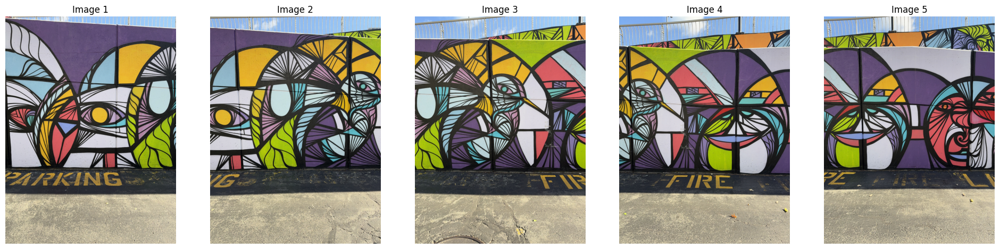

In [213]:
path = "./data/dataset_1"
r_images = load_images(path) 
images1 = []

target_width = 1000  # Desired width

for img in r_images:
    # Calculate the scale factor based on the target width
    scale_factor = target_width / img.shape[1]
    # Calculate the new height to maintain the aspect ratio
    new_height = int(img.shape[0] * scale_factor)
    # Resize the image
    resized_img = cv2.resize(img, (target_width, new_height), interpolation=cv2.INTER_AREA)
    images1.append(resized_img)

Images loaded successfully!


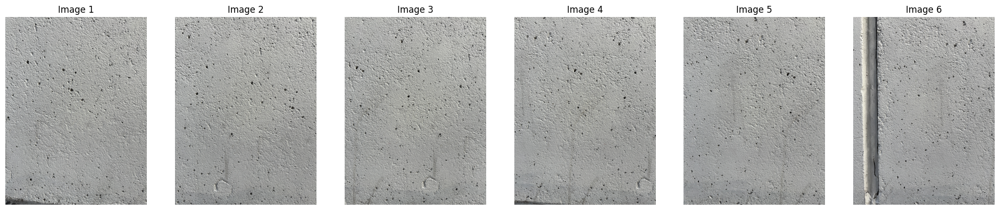

In [214]:
path = "./data/dataset_2"
r_images = load_images(path)  
images2 = []

target_width = 1000  # Desired width

for img in r_images:
    # Calculate the scale factor based on the target width
    scale_factor = target_width / img.shape[1]
    # Calculate the new height to maintain the aspect ratio
    new_height = int(img.shape[0] * scale_factor)
    # Resize the image
    resized_img = cv2.resize(img, (target_width, new_height), interpolation=cv2.INTER_AREA)
    images2.append(resized_img)

Images loaded successfully!


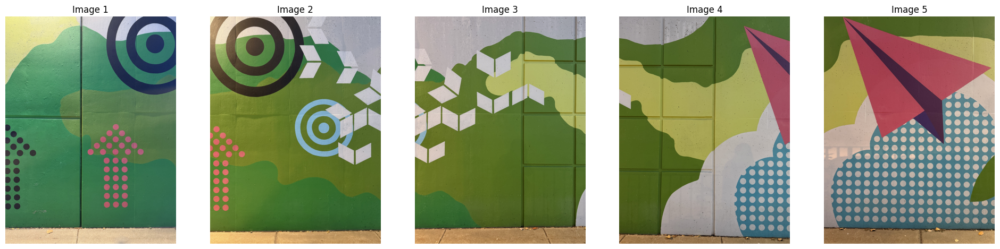

In [215]:
path = "./data/dataset_3"
r_images = load_images(path)  # Loads images into an array

images3 = []

target_width = 1000  # Desired width

for img in r_images:
    # Calculate the scale factor based on the target width
    scale_factor = target_width / img.shape[1]
    # Calculate the new height to maintain the aspect ratio
    new_height = int(img.shape[0] * scale_factor)
    # Resize the image
    resized_img = cv2.resize(img, (target_width, new_height), interpolation=cv2.INTER_AREA)
    images3.append(resized_img)

### Register Image Pairs
To create the panorama, start by registering successive image pairs using the following procedure:

1. Detect and match features between I(n) and I(n−1).

2. Estimate the geometric transformation, T(n), that maps I(n) to I(n−1).

3. Compute the transformation that maps I(n) into the panorama image as T(1)∗T(2)∗...∗T(n−1)∗T(n).

Initialize features of an image:

In [216]:
def convert_to_keypoints(ii, jj, size=1):
    return [cv2.KeyPoint(x=float(j), y=float(i), size=size) for i, j in zip(ii, jj)]

In this project, homographies (projective transformations) are applied to stitch images together. A homography is suitable here because our datasets consist of planar scenes with only translational movement and negligible rotation between camera poses.

Homographies represent 2D projective transformations, and it effectively models the relationships in planar scenes. However, for general 3D transformations, fundamental/essential matrices are used. 

In [217]:
def stitch_images(img1, img2, kp1, kp2, matches):
    img1_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    img2_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    H, _ = cv2.findHomography(img1_pts, img2_pts, cv2.RANSAC, 5.0)
    dst_padded, img1_warped = warpPerspectivePadded(img1, img2, H)
    stitched_image = masking(dst_padded, img1_warped, 0.5)
    return stitched_image

Iterate images and incrementally stitch them at each step to create the panorama. At each step, the features of the current image are matched with the stitched image with all the previous input images. Then, the homography between the two images is calculated using the matched SIFT features, which is then used to add the new image into the panorama. The canvas size (stitched image) is dynamically computed at each step to accommodate the new image (look at warpPerspectivePadded in utils.py). 

In [218]:
def create_panorama(images):
    stitched_image = images[0]
    sift = cv2.SIFT_create()

    for i in range(1, len(images)):
        # Use the Harris function to get the keypoints
        print(f"Stitching image {i-1} and {i}...")
        ii1, jj1, _ = harris(cv2.cvtColor(stitched_image, cv2.COLOR_RGB2GRAY), N=700)
        ii2, jj2, _ = harris(cv2.cvtColor(images[i], cv2.COLOR_RGB2GRAY), N=700)
        
        # Convert Harris corner points to OpenCV KeyPoints
        kp1 = convert_to_keypoints(ii1, jj1)
        kp2 = convert_to_keypoints(ii2, jj2)

        # Compute SIFT descriptors for Harris keypoints
        kp1, desc1 = sift.compute(stitched_image, kp1)
        kp2, desc2 = sift.compute(images[i], kp2)

        # Match descriptors
        matches = match_features(desc1, desc2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        draw_matches(stitched_image, images[i], kp1, kp2, matches, num_matches=30)

        # Stitch images
        stitched_image = stitch_images(stitched_image, images[i], kp1, kp2, matches)
    
    return stitched_image

Initially, I used the default value for N, which determines the maximum number of corner points to be detected in each image, set at 100. This worked well for images with more than 50% overlap. However, for the panorama with only 15% overlap, there were fewer than 20 good matches, causing the images to fail to stitch properly. I attempted to adjust the value of cv2.RANSAC, trying values from 1.0 to 10.0, and found that 5.0 gave the best results.

Next, I increased N to 500, which improved the first two panoramas but still didn’t work on the third one. Finally, setting N to 700 allowed all images to stitch correctly.

In the final output of all the panoramas, some visible errors indicate that the images didn’t align perfectly. These errors are due to variations in the angle, rotation, and distance from the wall when the photos were taken.

## Mural Photomosaic
The application of the Harris detector with adjusted parameters resulted in a well-distributed set of features across all images of the mural. The algorithm successfully aligned and stitched the images, producing a seamless panoramic view of the mural. The high overlap facilitated accurate feature matching and image blending.


Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 147


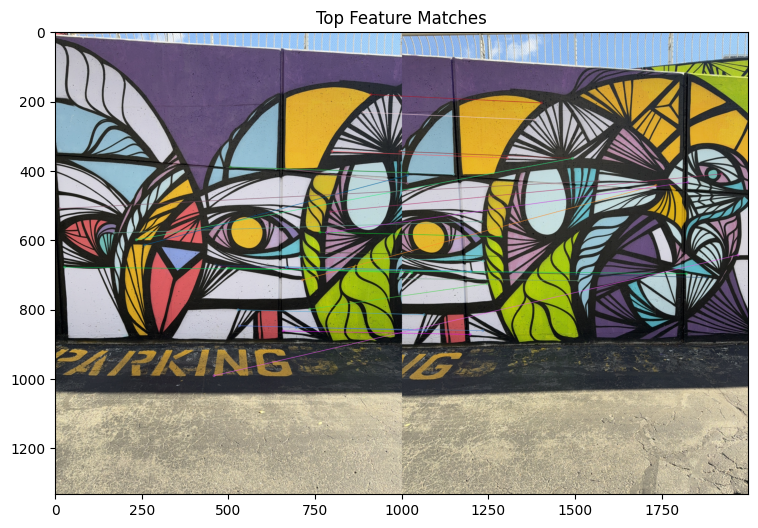

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 145


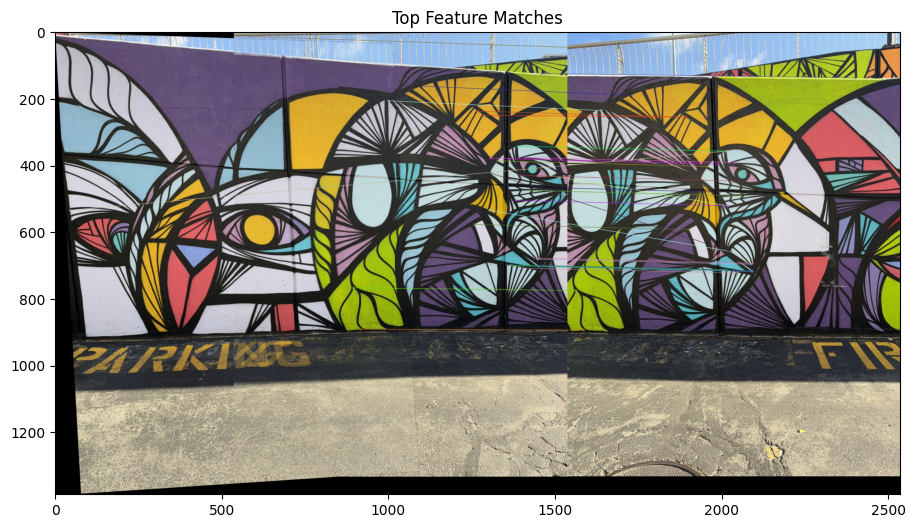

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 168


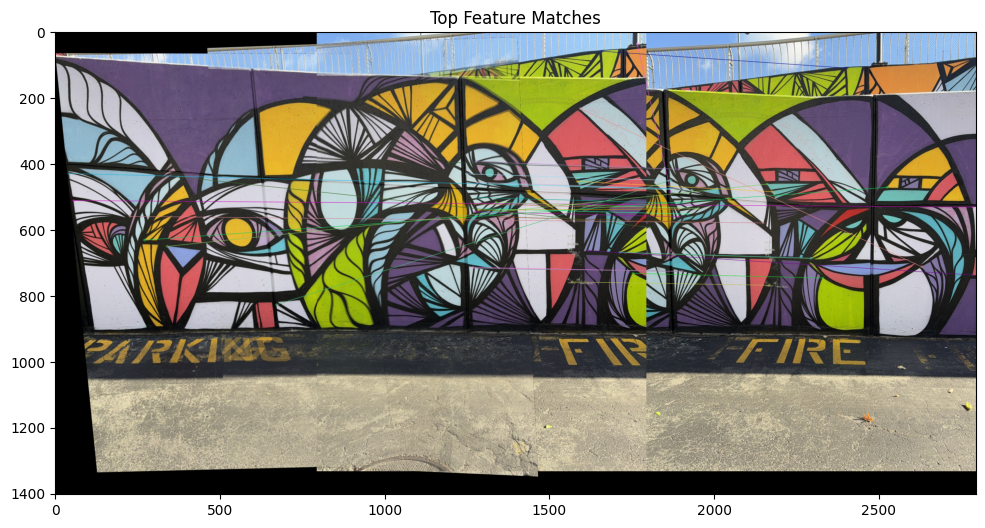

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 153


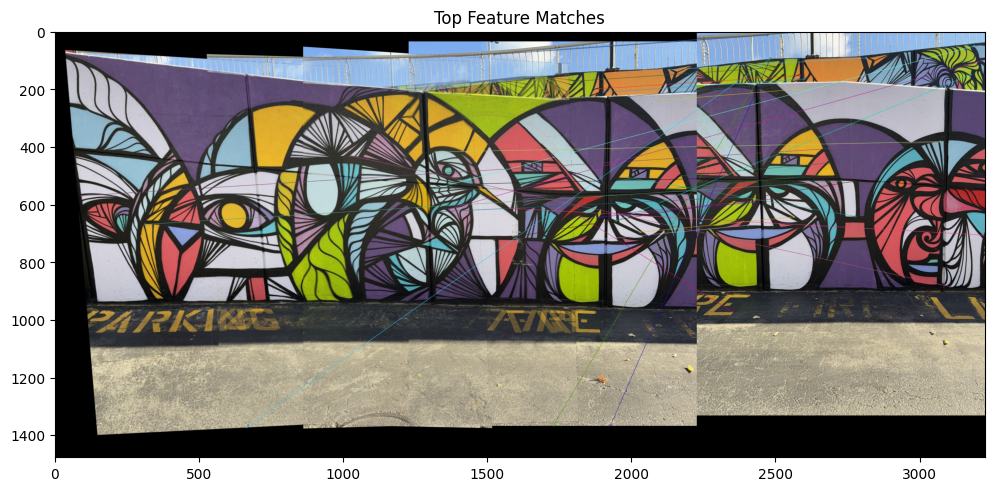

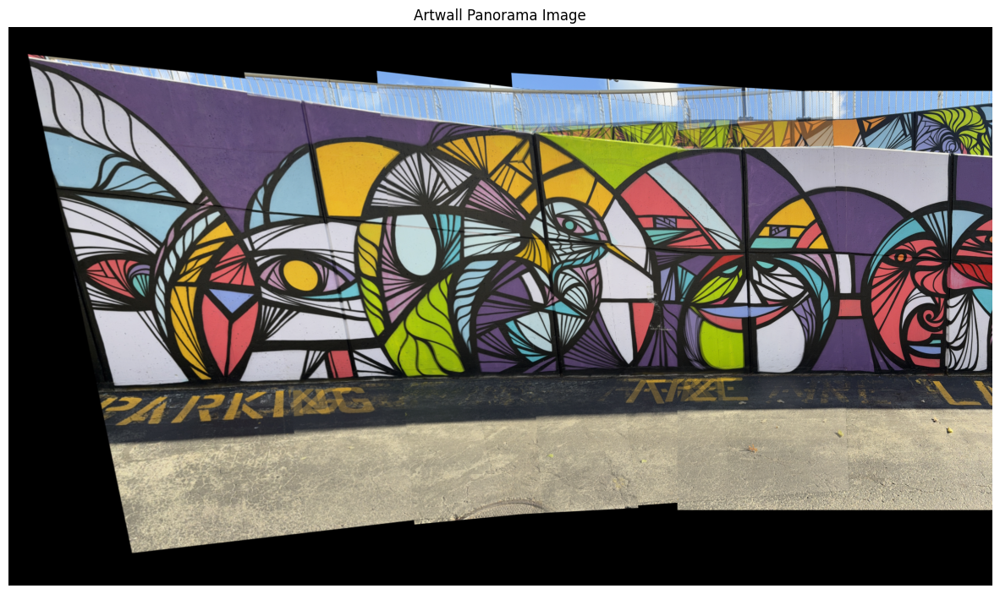

In [219]:
panorama1 = create_panorama(images1)

plt.figure(figsize=(15, 10))
plt.imshow(panorama1)
plt.title("Artwall Panorama Image")
plt.axis("off")
plt.show()

In the Mural Panorama, it is observed that there are around 150 matching points in every image but the final panorama looks curvy because of the orientation of the camera.  

## Cinder Block Wall Photomosaic
Similarly, the cinder block wall images were processed, yielding a coherent photomosaic. The uniform texture of the wall provided ample features for the Harris detector to identify, ensuring reliable stitching despite the simpler subject matter.


Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 116


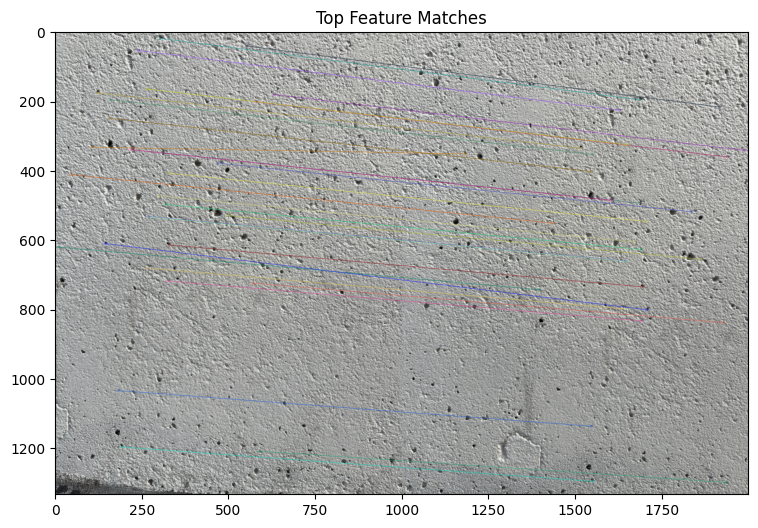

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 187


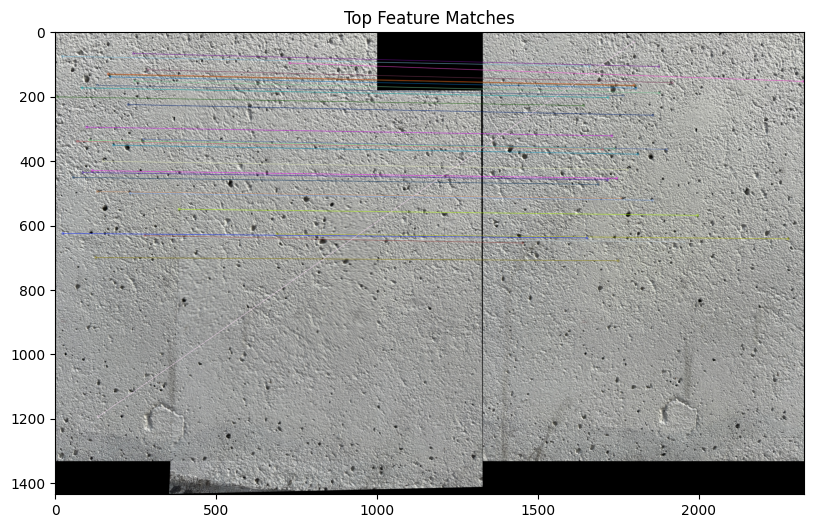

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 149


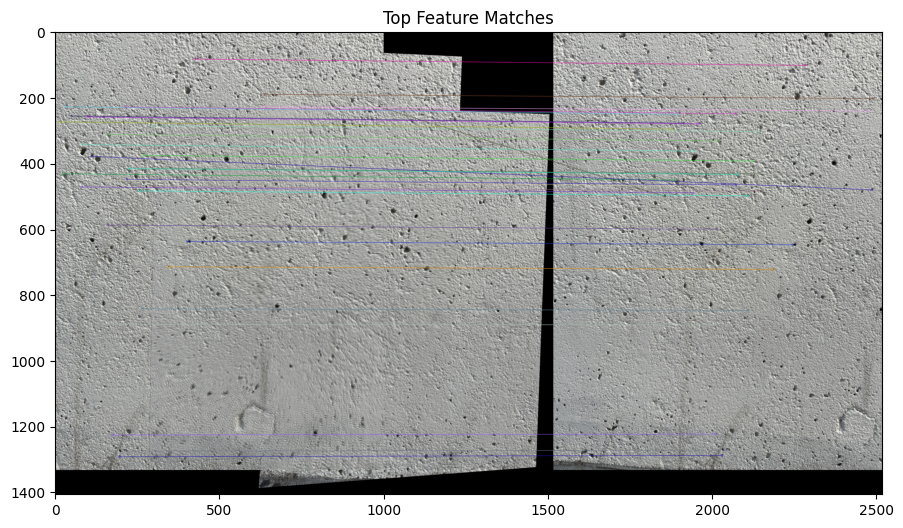

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 163


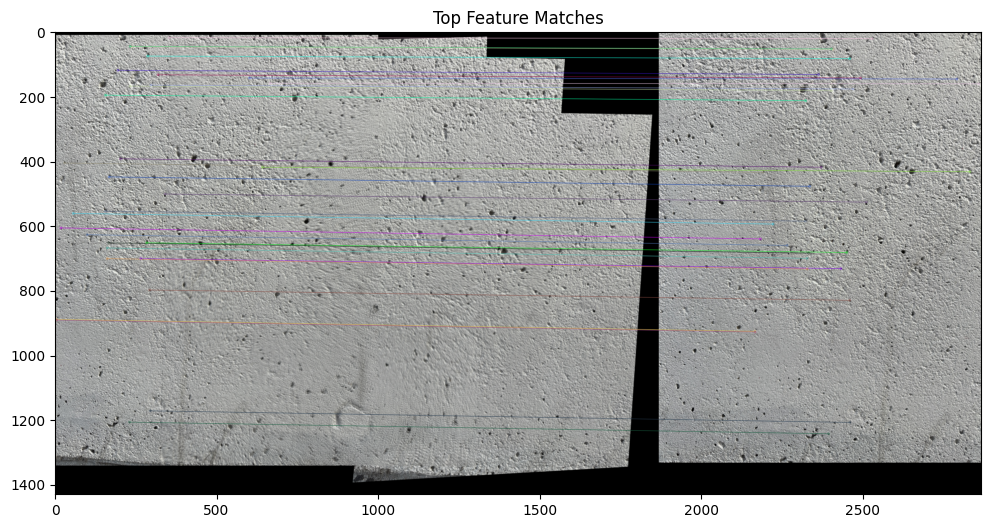

Stitching image 4 and 5...
Number of good matches between stitched image and image 5: 170


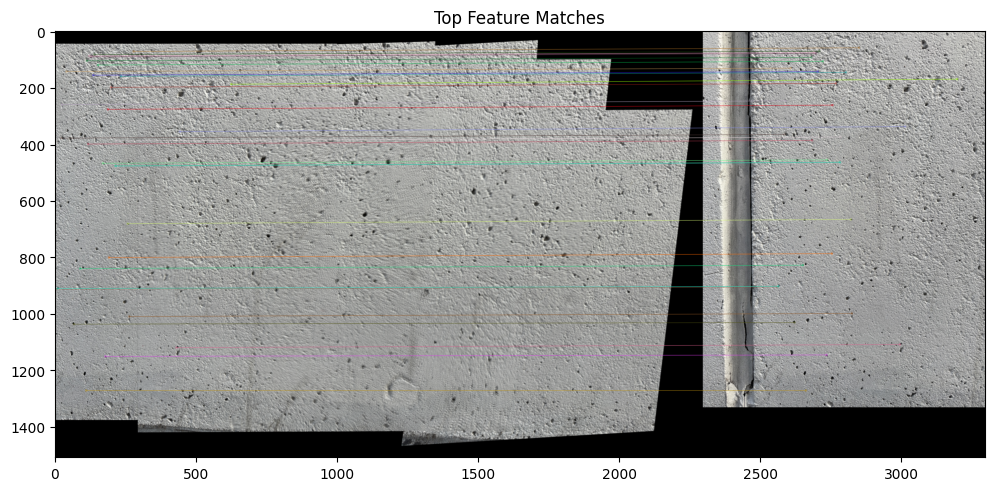

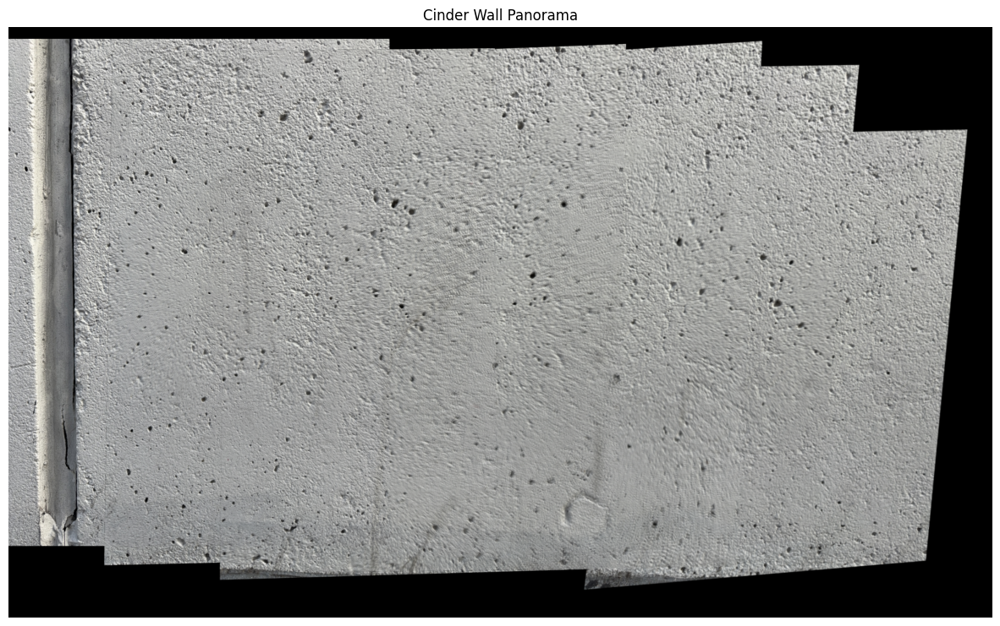

In [220]:
panorama2 = create_panorama(images2)

plt.figure(figsize=(15, 10))
plt.imshow(panorama2)
plt.title("Cinder Wall Panorama")
plt.axis("off")
plt.show()

In the Cinder Block Wall Panorama, the points are matching perfectly and it is observed that the stitched image looks like a staircase because it was captured while going upstairs. 

## 15% Overlap Photomosaic
When attempting to mosaic images with only 15% overlap, the algorithm faced challenges in accurately matching features due to the insufficient overlap. Despite adjustments to the Harris detector, the resulting mosaic exhibited noticeable misalignments and inconsistencies.


Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 66


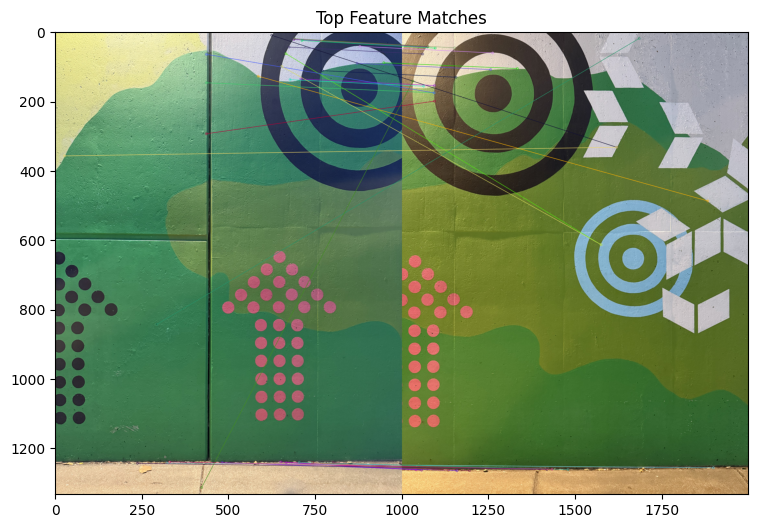

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 94


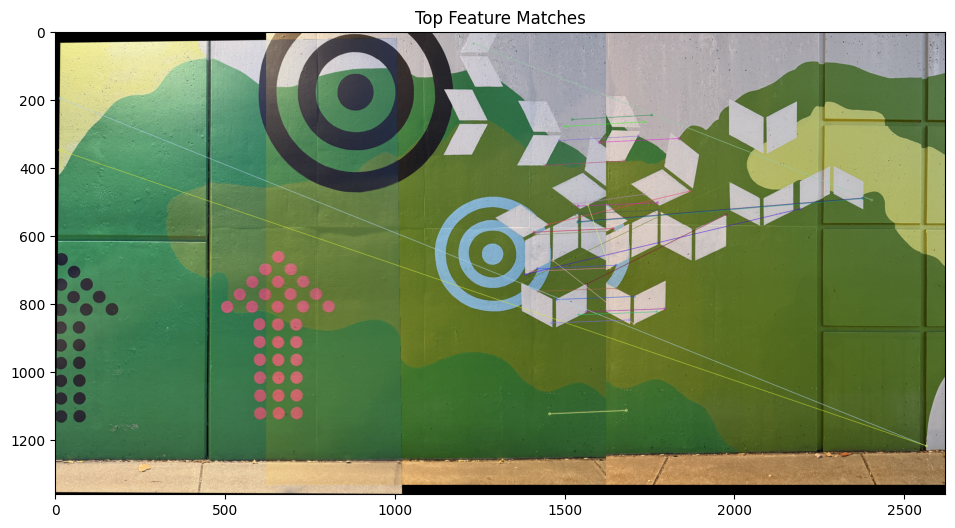

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 85


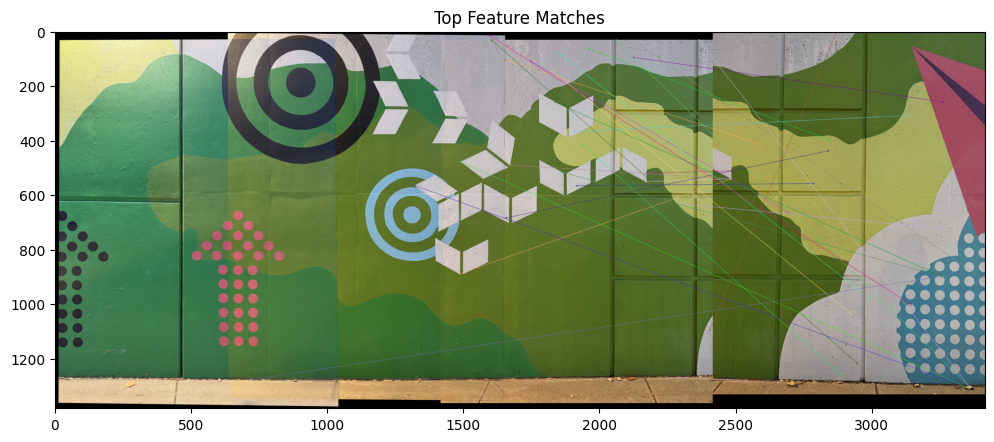

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 89


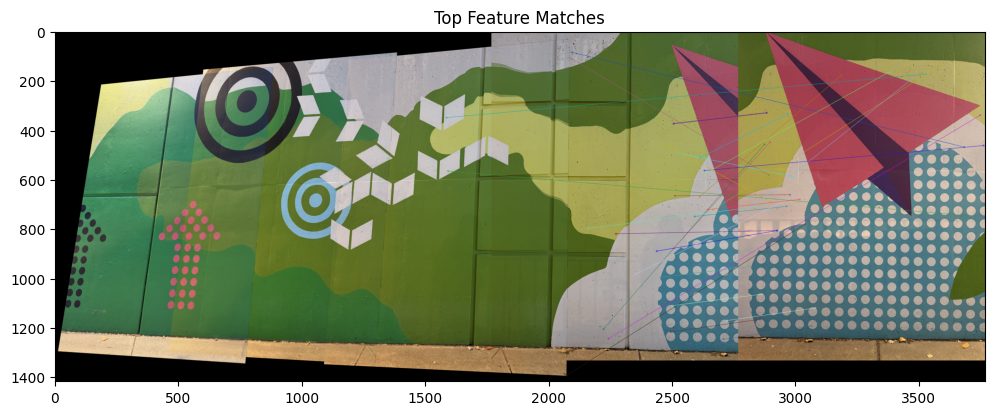

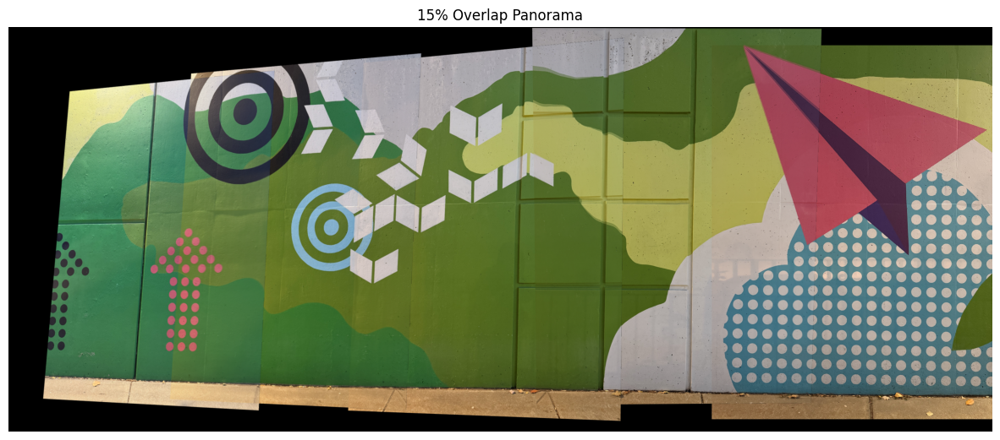

In [221]:
panorama3 = create_panorama(images3)

plt.figure(figsize=(15, 10))
plt.imshow(panorama3)
plt.title("15% Overlap Panorama")
plt.axis("off")
plt.show()

In the 15% Overlap Panorama there were very less matching points which made the panorama stitching difficult. As it can observed with more than 50% overlap, there were more than 100 matching points which made the matching relatively easier.